# Evolution of the Upper Vegetation Limit in the Lötschen Valley (Preparation notebook)

*SGG.00425: Data and methods for environmental analysis*

Author: Bart Kevin, Bosson Zoélie, Rey Thomas. Assisted by: Prof. POHL Eric & Prof. MACHGUTH Horst  

Date: November 6, 7, 13 and 14, 2025

## Importing necessary libraries

In [8]:
# import os

# # Define the root of the project by moving one directory up from the current working directory
# project_root = os.path.abspath(os.path.join(os.getcwd(), '..'))
# print("Project Root:", project_root)

In [9]:
# We need to import the sdc_utilities from the custom src folder
import sys                              # for system-specific parameters and functions
sys.path.append(r'..\src')              # add custom source directory to system path
from sdc_utilities import *             # import all utilities from sdc_utilities module

# Standard libraries
import numpy as np                      # for numerical operations  
import xarray as xr                     # for handling multi-dimensional arrays
import pandas as pd                     # for data manipulation and analysis
import matplotlib.pyplot as plt         # for plotting
import matplotlib.dates as mdates       # for handling dates in plots
import ipywidgets as widgets            # for interactive widgets in Jupyter notebooks
from IPython.display import display, clear_output

from pystac_client import Client        # for STAC API client
from shapely.geometry import Polygon    # for geometric objects
from odc.stac import stac_load          # for loading data from STAC
from pyproj import Proj, transform      # for coordinate transformations
from odc import loader                  # for data loading utilities
import odc                              # Open Data Cube utilities    

# Optional libraries
# import time                             # for measuring execution time
# import pyproj                           # for coordinate reference systems and transformations
# import psutil                           # for system and process utilities
# import dask.distributed                 # for parallel computing
# import rioxarray                        # for raster data handling with xarray
# import ast                              # for parsing strings into Python objects

# Silence warning (not recommended during development)
import warnings                         # to manage warnings
warnings.filterwarnings("ignore")       # ignore all warnings

## Get the right coordinates

Copy/paste the coordinates from [geojson](https://geojson.io/#map=2/0/20) and run the next cell to get the min and max latitudes and longitudes

In [10]:
# Lötschental Valley coordinates
coordinates = [
          [
            [
              7.723429408050947,
              46.422892799428894
            ],
            [
              7.78312614004011,
              46.360952360688714
            ],
            [
              7.9151997360218616,
              46.421733327723246
            ],
            [
              7.854782075842195,
              46.48256088910833
            ],
            [
              7.723429408050947,
              46.422892799428894
            ]
          ]
        ]
    
'''
Function to compute the min and max latitude and longitude from a list of coordinates.

Parameters:
- coordinates: List of lists containing latitude and longitude pairs.

Returns:
- A dictionary with min and max latitude and longitude.
'''
def min_max_latitude_longitude(coordinates):

    points = [pt for ring in coordinates for pt in ring]

    lons = [p[0] for p in points]
    lats = [p[1] for p in points]

    min_lon, max_lon = min(lons), max(lons)
    min_lat, max_lat = min(lats), max(lats)

    return {
        "longitude":(min_lon, max_lon),
        "latitude": (min_lat, max_lat)
    }

extent = min_max_latitude_longitude(coordinates)
# round extent coordinates to x decimal places
decimal_places = 5
rounded_extent = {k: tuple(round(v, decimal_places) for v in vals) for k, vals in extent.items()}

# Print the values
print(rounded_extent['longitude'])
print(rounded_extent['latitude'])

(7.72343, 7.9152)
(46.36095, 46.48256)


## Get the data from Swiss Data Cube

We will use the [Swiss Data Cube](https://explorer.swissdatacube.org/products) to get Landsat 5 and Landsat 8 surface reflectance data for our area of interest and time period.

The following cell are used to get the data we need from the Swiss Data Cube. Select your `product` (Landsat 5 or Landsat 8 or else), the `bands_names` you want to use, the `year` for which you want to get the data, and the `time_window` for that year (so you can get the data of July and August of 2015 and 2016 for exemple).

**Uncomment the cell and run it to get the data.** (Select all the lines and press `Ctrl + §`)

⚠️ Normally, you should not need to run this cell. The data has already been downloaded and pre-processed. There are stored in the `data/processed/` folder. You can directly load them from there in the next section. ⚠️

In [11]:
# # Configuration
# catalog = Client.open("https://explorer.swissdatacube.org/stac")

# # Select product and bands
# product = 'landsat_ot_c2_l2'    # Landsat 8
# # product = 'landsat_tm_c2_l2'    # Landsat 5
# bands_names = ['QA_PIXEL', 'blue', 'green', 'red', 'nir', 'swir_1', 'swir_2']

# # you can use either specify the real measurement names or the aliases (https://explorer.swissdatacube.org/products/landsat_ot_c2_l2)
# aliases = ['QA_PIXEL', 'blue', 'green', 'red', 'nir', 'swir_1', 'swir_2']
# measurements, aliases = get_alias_band(product,bands_names, measurements_file=r"..\data\raw\measurements_SwissDC.csv")

# longitude = (7.72343, 7.9152)       # Lötschental Valley longitude extent
# latitude = (46.36095, 46.48256)     # Lötschental Valley latitude extent

# crs = 'epsg:4326'                   # this is used because the coordinates are in lat/lon
# output_crs = 'epsg:2056'            # this is the Swiss coordinate system
# resolution = -30.0, 30.0            # 30m resolution

In [12]:
# # Select time range and load data
# # years = list(range(1984, 2012)) # Landsat 5 data from 1984 to 2011
# years = list(range(2013, 2026)) # Landsat 8 data from 2013 to 2025
# ds_list = []
# for y in years:
#     time_window = (f"{y}-07-01", f"{y}-09-15")  # summer period (vegetation growth)
#     try:
#         ds_y = load_product_ts(
#             catalog=catalog,
#             product=product,
#             time=time_window,
#             longitude=longitude,
#             latitude=latitude,
#             measurements=measurements,
#             output_crs=output_crs,
#             resolution=resolution,
#             rename=True,
#             alias_names=aliases
#         )
#     except ValueError as e:
#         if "empty sequence" in str(e):
#             print(f"No data for {y} (period {time_window})")
#             continue
#         else:
#             raise e

#     if ds_y is not None and ds_y.sizes.get("time", 0) > 0:
#         ds_list.append(ds_y)

# if ds_list:
#     dataset_in = xr.concat(ds_list, dim="time").sortby("time")
# else:
#     dataset_in = None

You can display the dataset to see if you get the right data

In [13]:
# dataset_in  # display the dataset

## Save the retrieved data

⚠️ Normally, you should not need to run this cell. The data has already been downloaded and pre-processed. There are stored in the `data/processed/` folder. You can directly load them from there in the next section. ⚠️

Save the retrieved data in a netcdf file to avoid having to re-download them each time.

In [14]:
# output_path = r"..\data\processed\dataset_in_landsat8_2013_2025.nc"    # specify the output path
# output_path = r"..\data\processed\dataset_in_landsat5_1984_2011.nc"    # specify the output path
# if os.path.exists(output_path):                                        # check if the file exist
#     os.remove(output_path)

# dataset_in.to_netcdf(output_path)                                      # save the dataset
# print(f"Dataset saved with success: {output_path}")

## Data analysis  Landsat 8 (2013-2025)

### Load the data from .nc file

Load the data from the netcdf file saved earlier.

In [15]:
dataset_landsat8 = xr.open_dataset(r"..\data\processed\dataset_in_landsat8_2013_2025.nc")

We clean the data by removing images where more than a certain percentage of the pixels are NaN (missing values).

In [16]:
# Compute the fraction of NaN over all bands and pixels for each time instant t
nan_fraction = dataset_landsat8.isnull().mean(dim=("x", "y", "variable")) if "variable" in dataset_landsat8.dims else dataset_landsat8.to_array().isnull().mean(dim=("x", "y", "variable"))
nan_fraction = dataset_landsat8.to_array().isnull().mean(dim=("x", "y", "variable"))    # If the dataset does not have a "variable" dimension yet (standard case)
valid_times = nan_fraction < 0.2                                                        # keep only images with less than 20% of NaN                                
ds_clean_landsat8 = dataset_landsat8.sel(time=dataset_landsat8.time[valid_times])       # select only valid times
dataset_landsat8.close()                                                                # close the original dataset to free memory
print(f"Images retained: {valid_times.sum().item()} out of {len(valid_times)}")         # print the number of images retained

Images retained: 79 out of 312


In [17]:
# ds_clean_landsat8

### Plot of cleaned images in RGB (red, green, blue)

We plot the Landsat 8 images in RGB (red, green, blue) $\rightarrow$ visible such that we can remove images with a lot of clouds.

In [18]:
# ncols = 6
# nrows = int(np.ceil(len(ds_clean_landsat8['time']) / ncols))
# subplot_width = 4                  
# subplot_height = 3                                 
# figsize = (subplot_width * ncols, subplot_height * nrows)

# ds_clean_landsat8[['red','green','blue']].to_array().plot.imshow(
#     col='time',
#     col_wrap=ncols,
#     robust=True,
#     figsize=figsize
# )

### Remove the pictures with clouds (manual selection)

#### Manual selection of images without clouds

We manually select the images without clouds by looking at the RGB plots. We create a list of the time indices of the images we want to keep.

In [19]:
dates_to_keep = np.array([
    '2013-07-23T10:18:52.000000000',
    '2014-09-12T10:17:03.000000000',
    '2015-08-30T10:16:42.000000000',
    '2016-08-16T10:16:58.000000000',
    '2017-08-19T10:16:58.000000000',
    '2018-08-06T10:16:15.000000000',
    '2019-08-25T10:17:05.000000000',
    '2020-08-27T10:17:01.000000000',
    '2021-08-14T10:17:02.000000000',
    '2022-08-01T10:17:20.000000000',
    '2023-08-20T10:16:52.000000000',
    '2024-08-06T10:16:27.000000000',
    '2025-08-25T10:16:57.000000000'
], dtype='datetime64[ns]')

# filter the cleaned dataset to keep only the specified dates
ds_filtered_landsat8 = ds_clean_landsat8.sel(time=dates_to_keep)

In [20]:
# ds_filtered_landsat8

#### Plot of selected images in RGB (red, green, blue)

We plot the selected Landsat 8 images in RGB (red, green, blue)

Text(0.5, 1.03, 'Landsat 8 RGB Time Series over Lötschental Valley (2013-2025)')

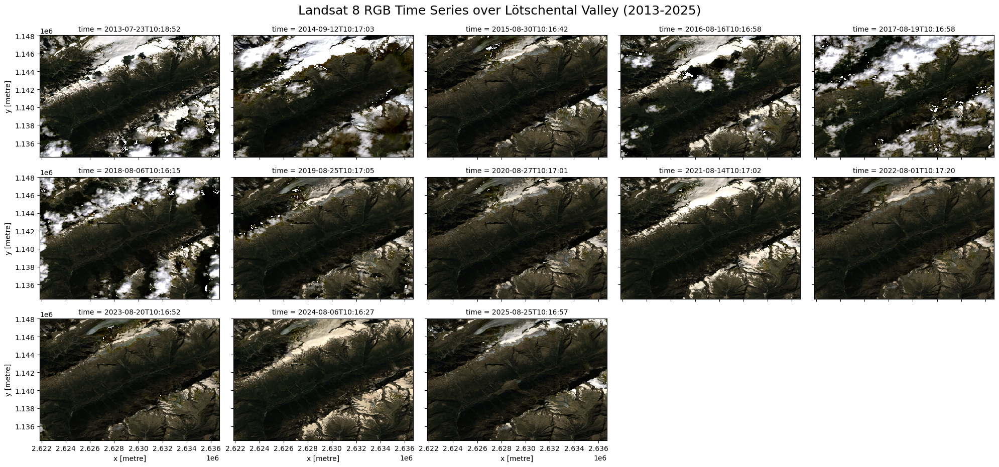

In [21]:
ncols = 5
nrows = int(np.ceil(len(ds_filtered_landsat8['time']) / ncols))
subplot_width = 4                  
subplot_height = 3                                 
figsize = (subplot_width * ncols, subplot_height * nrows)

g = ds_filtered_landsat8[['red','green','blue']].to_array().plot.imshow(
    col='time',
    col_wrap=ncols,
    robust=True,
    figsize=figsize
)

# Add a title to the entire figure
g.fig.suptitle("Landsat 8 RGB Time Series over Lötschental Valley (2013-2025)", fontsize=18, y=1.03)

# Save the figure
# plt.savefig(r"..\figures\landsat8_timeseries_2013_2025_rgb.png", dpi=600, bbox_inches='tight')

### Compute NDVI for Landsat 8

Now that we have an almost cloud-free dataset, we can compute the NDVI (Normalized Difference Vegetation Index) for each image.

Based on [spectral-indices-with-multispectral-satellite-data](https://www.geo.university/pages/spectral-indices-with-multispectral-satellite-data) we can compute the NDVI as follows:

$$
\text{NDVI} = \frac{\text{NIR} - \text{RED}}{\text{NIR} + \text{RED}}
$$

where NIR is the Near Infrared band and RED is the Red band.

However, because our analysis spans a long time series that requires integrating both Landsat 8 (L8) and Landsat 5 (L5) data, we must first ensure the datasets are spectrally compatible. Based on this paper [Spectral Adjustment Model's Analysis and Application to Remote Sensing Data](https://ieeexplore.ieee.org/document/8605361/metrics#metrics), we apply a linear correction to the Landsat 8 band values to match those of Landsat 5. This requires the following transformation:

1.  **DN to Surface Reflectance (SR) Scaling:** We convert the raw DN pixel values into physical $\rho$ values using the standard USGS scaling factor ($0.0000275$) and offset ($-0.2$) for Landsat Collection 2, Level-2 Surface Reflectance products.

2.  **Masking:** the scaling produces some artifacts for very low reflectance values (e.g., deep shadows). To avoid these artifacts, we apply a mask based on the NIR band (where we see those shadow correspond to really dark pixels). We mask out any pixels where the NIR value is $< 0.02$ to $\text{NaN}$. We apply this mask to both the NIR and RED bands.

3.  **Linear correction:** We apply the linear correction to the NIR and RED bands using the following equations derived from the literature:
    $$\overline{\rho}_{\lambda, ref} = a + b \cdot \overline{\rho}_{\lambda, tar} \tag{1}$$
    here $\overline{\rho}_{\lambda, ref}$ is the reference (Landsat 8) and $\overline{\rho}_{\lambda, tar}$ is the target (Landsat 5) band reflectance. Solving equation (1) for $\rho_{\lambda, tar}$ gives:
    $$\overline{\rho}_{\lambda, tar} = \frac{\overline{\rho}_{\lambda, ref} - a}{b} \tag{2}$$
    where the coefficients $a$ and $b$ are specific to each band:
    - For the red band:
        - $a = -0.00207016521541508$
        - $b = 0.995456030450696$
    - For the NIR band:
        - $a = 0.00630669064472072$
        - $b = 1.00470811352545$

4. **Compute the NDVI:** Finally, we compute the NDVI using the corrected $\rho_{\text{NIR, corrected}}$ and $\rho_{\text{red, corrected}}$ values in the standard NDVI formula:
    $$
    \text{NDVI}_{\text{corrrected}} = \frac{\rho_{\text{NIR, corrected}} - \rho_{\text{red, corrected}}}{\rho_{\text{NIR, corrected}} + \rho_{\text{red, corrected}}} \tag{3}
    $$

5. **Final check (masking):** If there is still any artifact pixels (e.g., $\text{NDVI}_{\text{corrrected}}$ $< -1$ or $\text{NDVI}_{\text{corrrected}}$ $> 1$), we mask them to NaN.

#### Apply the scaling, masking, linear correction, and compute NDVI

In [22]:
# create a copy to avoid modifying the original data
ds_l8_to_l5 = ds_filtered_landsat8.copy()

# coefficients L8 -> L5 from the excel table in the paper
a_red, b_red = -0.00207016521541508, 0.995456030450696
a_nir, b_nir =  0.00630669064472072, 1.00470811352545

# parameters to scale DN (Digital Number) to reflectance (USGS)
scale_factor = 0.0000275
offset = -0.2

# STEP 1: Scale DN to reflectance
ds_l8_to_l5['red_corrected'] = ds_l8_to_l5['red'] * scale_factor + offset
ds_l8_to_l5['nir_corrected'] = ds_l8_to_l5['nir'] * scale_factor + offset

# STEP 2: mask pixels where nir > threshold i.e. zone where there is to much shadow or slope
threshold_shadow = 0.02         # We adjust this threshold based on the next plot  
valid_condition = ds_l8_to_l5['nir_corrected'] > threshold_shadow

# apply the condition to both bands
ds_l8_to_l5['red_corrected'] = ds_l8_to_l5['red_corrected'].where(valid_condition)
ds_l8_to_l5['nir_corrected'] = ds_l8_to_l5['nir_corrected'].where(valid_condition)
print("After scaling (red) min/max:", float(ds_l8_to_l5['red_corrected'].min()), float(ds_l8_to_l5['red_corrected'].max()))
print("After scaling (nir) min/max:", float(ds_l8_to_l5['nir_corrected'].min()), float(ds_l8_to_l5['nir_corrected'].max()))

# STEP 3: Apply the linear transformation to convert L8 reflectance to L5 reflectance
red_corr = (ds_l8_to_l5['red_corrected'] - a_red) / b_red     # correct red band using equation (2)
nir_corr = (ds_l8_to_l5['nir_corrected'] - a_nir) / b_nir     # correct nir band using equation (2)

# STEP 4: compute NDVI with corrected bands
ndvi_corr = (nir_corr - red_corr) / (nir_corr + red_corr)
print("NDVI min/max:", float(ndvi_corr.min()), float(ndvi_corr.max()))

# STEP 5: final mask to get rid of artifacts
final_mask = (ndvi_corr >= -1.0) & (ndvi_corr <= 1.0)
ndvi_corr = ndvi_corr.where(final_mask)
print("NDVI after final mask min/max:", float(ndvi_corr.min()), float(ndvi_corr.max()))

# Append the new values to the dataset
ds_l8_to_l5['red_corrected'] = red_corr
ds_l8_to_l5['nir_corrected'] = nir_corr
ds_l8_to_l5['NDVI'] = ndvi_corr

After scaling (red) min/max: -0.14530250430107117 1.3927724361419678
After scaling (nir) min/max: 0.02002750337123871 1.3558675050735474
NDVI min/max: -18675.6171875 27231.361328125
NDVI after final mask min/max: -0.825971782207489 0.9997472167015076


In [23]:
# ds_l8_to_l5

#### Plot of Red, NIR bands and NDVI for a selected date

We plot the Red band, NIR band and NDVI for a selected date using a dropdown menu. This allows us to visually inspect the results of our NDVI computation and adjust our thresholds if necessary.

In [24]:
# Widget dropdown
dates_dropdown_l8 = widgets.Dropdown(
    options=[(str(d)[:19], i) for i, d in enumerate(ds_l8_to_l5['time'].values)],
    description='Date:',
    value=0
)
print("You can select a date from the dropdown menu to update the plots.")
display(dates_dropdown_l8)

# Function to update the plot based on the selected date
def update_plot(change):
    clear_output(wait=True)     # Clear the previous plot
    display(dates_dropdown_l8)  # Redisplay the widget
    date_index_to_plot = change["new"]

    sample_red = ds_l8_to_l5['red_corrected'].isel(time=date_index_to_plot)
    sample_nir = ds_l8_to_l5['nir_corrected'].isel(time=date_index_to_plot)
    sample_ndvi = ds_l8_to_l5['NDVI'].isel(time=date_index_to_plot)
    date_format = str(ds_l8_to_l5['time'][date_index_to_plot].values)[:19]
    
    plt.figure(figsize=(24, 6))

    # --- 1. Plot of the band Red
    ax1 = plt.subplot(131)
    sample_red.plot.imshow(ax=ax1, cmap='gray', vmin=0.0, vmax=1.0, robust=True,
        cbar_kwargs={'label': 'Red Reflectance (L8 Scaled)'}
    )
    ax1.set_title(f"Red Band", fontsize=14)
    ax1.set_aspect('equal')

    # --- 2. Plot of the NIR band
    ax2 = plt.subplot(132)
    sample_nir.plot.imshow(ax=ax2, cmap='gray', vmin=0.0, vmax=1.0, robust=True,
        cbar_kwargs={'label': 'NIR Reflectance (L8 Scaled)'}
    )
    ax2.set_title(f"NIR Band", fontsize=14)
    ax2.set_aspect('equal')

    # --- 3. Plot of the NDVI
    ax3 = plt.subplot(133)
    sample_ndvi.plot.imshow(ax=ax3, cmap='RdYlGn', vmin=-1.0, vmax=1.0, robust=True,
        cbar_kwargs={'label': 'NDVI (Corrected)'}
    )
    ax3.set_title(f"NDVI (Corrected)", fontsize=14)
    ax3.set_aspect('equal')

    # Add a title to the entire figure
    plt.suptitle(f"Satellite Imagery on {date_format}", fontsize=18, y=1.03)

    plt.tight_layout()
    # Save the figure, this can take some time be patient
    # plt.savefig(r"..\figures\red_nir_ndvi_" + date_format.replace(":", "-") + ".png", dpi=300, bbox_inches='tight')
    plt.show()

# Run the update function
dates_dropdown_l8.observe(update_plot, names="value")

You can select a date from the dropdown menu to update the plots.


Dropdown(description='Date:', options=(('2013-07-23T10:18:52', 0), ('2014-09-12T10:17:03', 1), ('2015-08-30T10…

#### Plot time series of NDVI images after correction

Text(0.5, 1.03, 'Corrected NDVI Time Series over Lötschental Valley (2013-2025)')

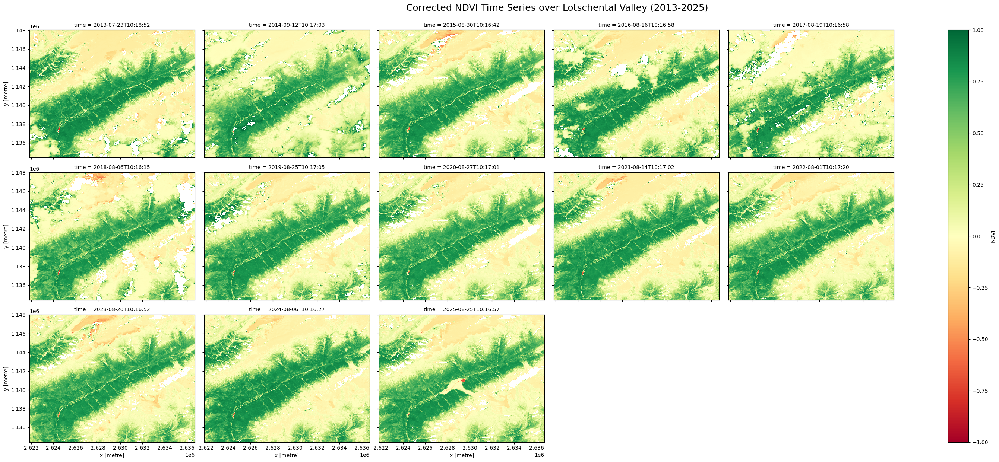

In [25]:
ncols = 5                            
nrows = int(np.ceil(len(ds_l8_to_l5['time']) / ncols))
subplot_width = 6                           
subplot_height = 4                              
figsize = (subplot_width * ncols, subplot_height * nrows)

g1 = ds_l8_to_l5['NDVI'].plot.imshow(
    col='time',
    col_wrap=ncols,
    vmin=-1.0,
    vmax=1.0,
    robust=True,
    cmap='RdYlGn',
    figsize=figsize
)

# Add a title to the entire figure
g1.fig.suptitle("Corrected NDVI Time Series over Lötschental Valley (2013-2025)", fontsize=18, y=1.03)

# Save the figure
# plt.savefig(r"..\figures\landsat8_timeseries_2013_2025_ndvi_corrected.png", dpi=600, bbox_inches='tight')

Now we see that for each date, we have the NDVI computed from the corrected Landsat 8 data. We see that some pixel are white that's the NaN values where we had artifacts. We still have some clouds in some images but overall the NDVI looks much better now. We might remove some more images with clouds later if needed.

## Data analysis  Landsat 5 (1984-2011)

### Load the data from .nc file

Load the data from the netcdf file saved earlier.

In [26]:
dataset_landsat5 = xr.open_dataset(r"..\data\processed\dataset_in_landsat5_1984_2011.nc")

We clean the data by removing images where more than x% of the pixels are NaN (missing values).

In [27]:
# Compute the fraction of NaN over all bands and pixels for each time instant t
nan_fraction = dataset_landsat5.isnull().mean(dim=("x", "y", "variable")) if "variable" in dataset_landsat5.dims else dataset_landsat5.to_array().isnull().mean(dim=("x", "y", "variable"))
nan_fraction = dataset_landsat5.to_array().isnull().mean(dim=("x", "y", "variable"))    # If the dataset does not have a "variable" dimension yet (standard case)
valid_times = nan_fraction < 0.2                                                        # keep only images with less than 20% of NaN
ds_clean_landsat5 = dataset_landsat5.sel(time=dataset_landsat5.time[valid_times])       # select only valid times
dataset_landsat5.close()                                                                # close the original dataset to free memory
print(f"Images retenues : {valid_times.sum().item()} sur {len(valid_times)}")           # print the number of images retained

Images retenues : 107 sur 452


### Plot of cleaned images in RGB (red, green, blue)

We plot the Landsat 5 images in RGB (red, green, blue) $\rightarrow$ visible such that we can remove images with a lot of clouds.

In [28]:
# ncols = 6
# nrows = int(np.ceil(len(ds_clean_landsat5['time']) / ncols))
# subplot_width = 4
# subplot_height = 3
# figsize = (subplot_width * ncols, subplot_height * nrows)

# ds_clean_landsat5[['red','green','blue']].to_array().plot.imshow(
#     col='time',
#     col_wrap=ncols,
#     robust=True,
#     figsize=figsize
# )

### Remove the pictures with clouds (manual selection)

#### Manual selection of images without clouds

We manually select the images without clouds by looking at the RGB plots. We create a list of the time indices of the images we want to keep.

In [29]:
dates_to_keep = np.array([
    '1984-09-02T09:40:47.000000000',
    '1985-07-10T09:46:52.000000000',
    '1986-09-15T09:37:27.000000000',
    '1987-08-17T09:43:00.000000000',
    '1988-07-18T09:47:37.000000000',
    '1989-07-21T09:44:08.000000000',
    '1990-08-09T09:36:53.000000000',
    '1991-08-28T09:40:35.000000000',
    '1992-09-15T09:39:00.000000000',
    '1993-09-02T09:39:16.000000000',
    '1994-08-04T09:34:29.000000000',
    '1995-07-22T09:21:25.000000000',
    '1996-09-10T09:34:21.000000000',
    '1997-07-27T09:47:47.000000000',
    '1998-08-31T09:55:33.000000000',
    '1999-09-03T09:54:01.000000000',
    '2000-08-20T09:54:37.000000000',
    '2001-08-23T09:57:09.000000000',
    '2003-08-13T09:53:49.000000000',
    '2004-08-31T10:00:21.000000000',
    '2005-08-18T10:04:57.000000000',
    '2006-07-20T10:10:01.000000000',
    '2007-08-24T10:10:09.000000000',
    '2008-07-25T10:03:26.000000000',
    '2009-07-28T10:05:57.000000000',
    '2010-07-31T10:07:19.000000000',
    '2011-07-02T10:06:07.000000000'
], dtype='datetime64[ns]')

# filter the cleaned dataset to keep only the specified dates
ds_filtered_landsat5 = ds_clean_landsat5.sel(time=dates_to_keep)

In [30]:
# ds_filtered_landsat5

#### Plot of selected images in RGB (red, green, blue)

We plot the selected Landsat 5 images in RGB (red, green, blue)

Text(0.5, 1.03, 'Landsat 5 RGB Time Series over Lötschental Valley (1984-2011)')

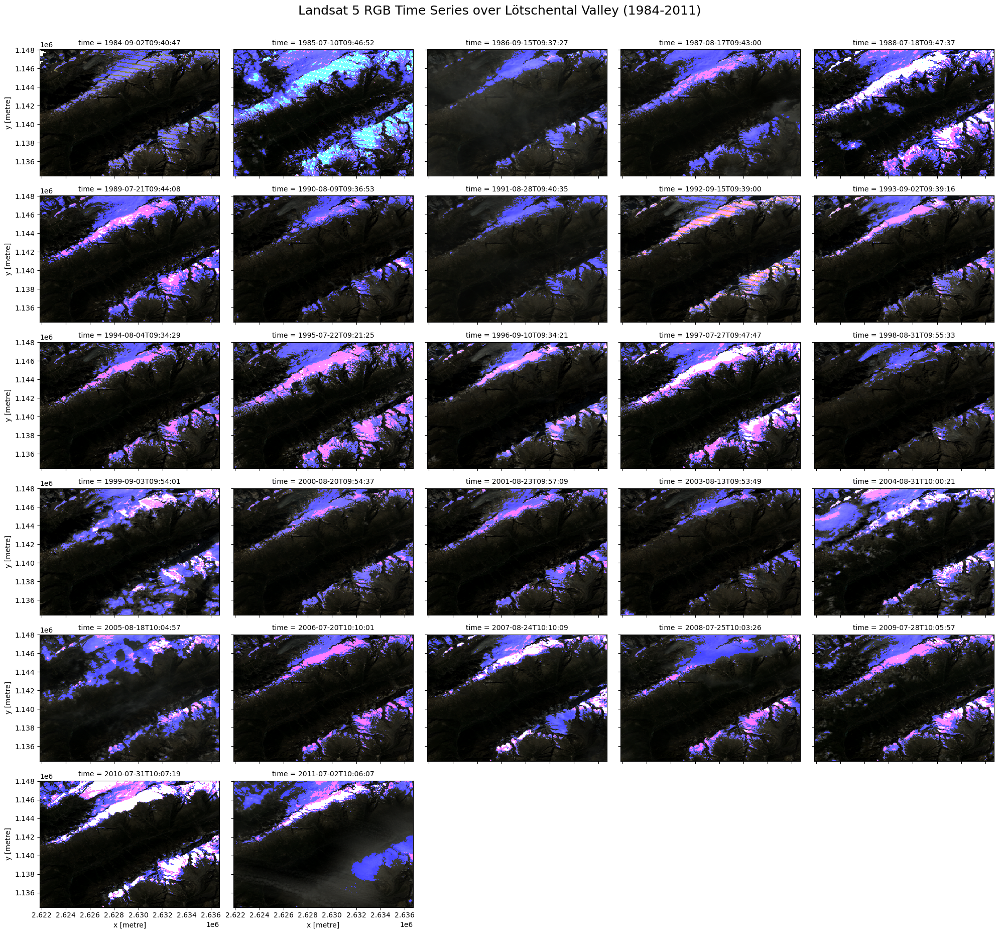

In [31]:
ncols = 5
nrows = int(np.ceil(len(ds_filtered_landsat5['time']) / ncols))
subplot_width = 4                  
subplot_height = 3                                 
figsize = (subplot_width * ncols, subplot_height * nrows)

g = ds_filtered_landsat5[['red','green','blue']].to_array().plot.imshow(
    col='time',
    col_wrap=ncols,
    robust=True,
    figsize=figsize
)

# Add a title to the entire figure
g.fig.suptitle("Landsat 5 RGB Time Series over Lötschental Valley (1984-2011)", fontsize=18, y=1.03)

# Save the figure
# plt.savefig(r"..\figures\landsat5_timeseries_1984_2011_rgb.png", dpi=600, bbox_inches='tight')

### Compute NDVI for Landsat 5

Now that we have an almost cloud-free dataset, we can compute the NDVI (Normalized Difference Vegetation Index) for each image.

Based on [spectral-indices-with-multispectral-satellite-data](https://www.geo.university/pages/spectral-indices-with-multispectral-satellite-data) we can compute the NDVI as follows:

$$
\text{NDVI} = \frac{\text{NIR} - \text{RED}}{\text{NIR} + \text{RED}}
$$

where NIR is the Near Infrared band and RED is the Red band.

As we want to combine the NDVI time series from Landsat 5 and Landsat 8, we need to ensure that the NDVI values from both sensors are comparable. For Landsat 8 we had to apply a linear correction to the band reflectance values before computing the NDVI. However, for Landsat 5, we follow the same procedure but without the linear correction step, as Landsat 5 data is used as the reference in our analysis.

So we just need to:
1.  **DN to Surface Reflectance (SR) Scaling**
2.  **Mask the shadows**
3.  **Compute the NDVI**
4.  **Final check (masking)**



#### Apply the scaling, masking, linear correction, and compute NDVI

In [32]:
# create a copy to avoid modifying the original data
ds_l5_scaled = ds_filtered_landsat5.copy()

# coefficients L8 -> L5 from the excel table in the paper
a_red, b_red = -0.00207016521541508, 0.995456030450696
a_nir, b_nir =  0.00630669064472072, 1.00470811352545

# parameters to scale DN (Digital Number) to reflectance (USGS)
scale_factor = 0.0000275
offset = -0.2

# STEP 1: Scale DN to reflectance
ds_l5_scaled['red_corrected'] = ds_l5_scaled['red'] * scale_factor + offset
ds_l5_scaled['nir_corrected'] = ds_l5_scaled['nir'] * scale_factor + offset

# STEP 2: mask pixels where nir > threshold i.e. zone where there is to much shadow or slope
threshold_shadow = 0.02         # We adjust this threshold based on the next plot  
valid_condition = ds_l5_scaled['nir_corrected'] > threshold_shadow

# apply the condition to both bands
ds_l5_scaled['red_corrected'] = ds_l5_scaled['red_corrected'].where(valid_condition)
ds_l5_scaled['nir_corrected'] = ds_l5_scaled['nir_corrected'].where(valid_condition)
print("After scaling (red) min/max:", float(ds_l5_scaled['red_corrected'].min()), float(ds_l5_scaled['red_corrected'].max()))
print("After scaling (nir) min/max:", float(ds_l5_scaled['nir_corrected'].min()), float(ds_l5_scaled['nir_corrected'].max()))

# STEP 3: compute NDVI with corrected bands
ndvi_corr_l5 = (ds_l5_scaled['nir_corrected'] - ds_l5_scaled['red_corrected']) / (ds_l5_scaled['nir_corrected'] + ds_l5_scaled['red_corrected'])
print("NDVI min/max:", float(ndvi_corr_l5.min()), float(ndvi_corr_l5.max()))

# STEP 4: final mask to get rid of artifacts
final_mask = (ndvi_corr_l5 >= -1.0) & (ndvi_corr_l5 <= 1.0)
ndvi_corr_l5 = ndvi_corr_l5.where(final_mask)
print("NDVI after final mask min/max:", float(ndvi_corr_l5.min()), float(ndvi_corr_l5.max()))

# Append the new values to the dataset
ds_l5_scaled['NDVI'] = ndvi_corr_l5

After scaling (red) min/max: -0.002907499670982361 1.6022124290466309
After scaling (nir) min/max: 0.02002750337123871 1.6022124290466309
NDVI min/max: -0.6595891118049622 1.1517316102981567
NDVI after final mask min/max: -0.6595891118049622 0.9992514252662659


In [33]:
# ds_l5_scaled

#### Plot of Red, NIR bands and NDVI for a selected date

We plot the Red band, NIR band and NDVI for a selected date using a dropdown menu. This allows us to visually inspect the results of our NDVI computation and adjust our thresholds if necessary.

In [34]:
# Widget dropdown
dates_dropdown_l5 = widgets.Dropdown(
    options=[(str(d)[:19], i) for i, d in enumerate(ds_l5_scaled['time'].values)],
    description='Date:',
    value=0
)
print("You can select a date from the dropdown menu to update the plots.")
display(dates_dropdown_l5)

# Function to update the plot based on the selected date
def update_plot(change):
    clear_output(wait=True)  # Clear the previous plot
    display(dates_dropdown_l5)  # Redisplay the widget
    date_index_to_plot = change["new"]

    sample_red = ds_l5_scaled['red_corrected'].isel(time=date_index_to_plot)
    sample_nir = ds_l5_scaled['nir_corrected'].isel(time=date_index_to_plot)
    sample_ndvi = ds_l5_scaled['NDVI'].isel(time=date_index_to_plot)
    date_format = str(ds_l5_scaled['time'][date_index_to_plot].values)[:19]
    
    plt.figure(figsize=(24, 6))

    # --- 1. Plot of the band Red
    ax1 = plt.subplot(131)
    sample_red.plot.imshow(ax=ax1, cmap='gray', vmin=0.0, vmax=1.0, robust=True,
        cbar_kwargs={'label': 'Red Reflectance (L8 Scaled)'}
    )
    ax1.set_title(f"Red Band", fontsize=14)
    ax1.set_aspect('equal')

    # --- 2. Plot of the NIR band
    ax2 = plt.subplot(132)
    sample_nir.plot.imshow(ax=ax2, cmap='gray', vmin=0.0, vmax=1.0, robust=True,
        cbar_kwargs={'label': 'NIR Reflectance (L8 Scaled)'}
    )
    ax2.set_title(f"NIR Band", fontsize=14)
    ax2.set_aspect('equal')

    # --- 3. Plot of the NDVI
    ax3 = plt.subplot(133)
    sample_ndvi.plot.imshow(ax=ax3, cmap='RdYlGn', vmin=-1.0, vmax=1.0, robust=True,
        cbar_kwargs={'label': 'NDVI (Corrected)'}
    )
    ax3.set_title(f"NDVI (Corrected)", fontsize=14)
    ax3.set_aspect('equal')

    # Add a title to the entire figure
    plt.suptitle(f"Satellite Imagery on {date_format}", fontsize=18, y=1.03)

    plt.tight_layout()
    # Save the figure, this can take some time be patient
    # plt.savefig(r"..\figures\red_nir_ndvi_" + date_format.replace(":", "-") + ".png", dpi=300, bbox_inches='tight')
    plt.show()

# Run the update function
dates_dropdown_l5.observe(update_plot, names="value")

You can select a date from the dropdown menu to update the plots.


Dropdown(description='Date:', options=(('1984-09-02T09:40:47', 0), ('1985-07-10T09:46:52', 1), ('1986-09-15T09…

#### Plot time series of NDVI images

Text(0.5, 1.03, 'Corrected NDVI Time Series over Lötschental Valley (1984-2011)')

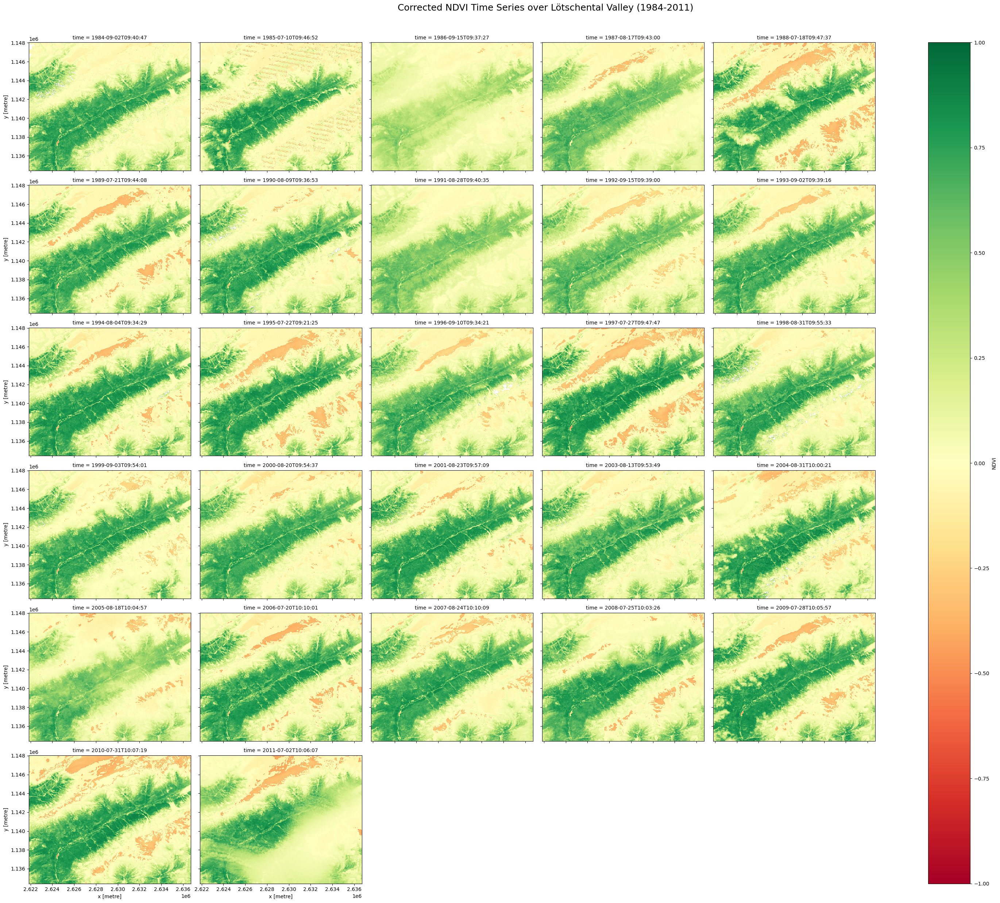

In [35]:
ncols = 5                            
nrows = int(np.ceil(len(ds_l5_scaled['time']) / ncols))
subplot_width = 6                           
subplot_height = 4                              
figsize = (subplot_width * ncols, subplot_height * nrows)

g1 = ds_l5_scaled['NDVI'].plot.imshow(
    col='time',
    col_wrap=ncols,
    vmin=-1.0,
    vmax=1.0,
    robust=True,
    cmap='RdYlGn',
    figsize=figsize
)

# Add a title to the entire figure
g1.fig.suptitle("Corrected NDVI Time Series over Lötschental Valley (1984-2011)", fontsize=18, y=1.03)

# Save the figure
# plt.savefig(r"..\figures\landsat5_timeseries_1984_2011_ndvi_corrected.png", dpi=600, bbox_inches='tight')

## Fusion of the two datasets (Landsat 5 and Landsat 8 corrected)

Fusion of the two datasets into one dataset and save it as .nc file.

First we check that the coordinates of both datasets match and that we have the same bands.

In [36]:
# ds_l8_to_l5

In [37]:
# ds_l5_scaled

In [38]:
x_min, x_max, y_min, y_max = float(ds_l8_to_l5.x.min()), float(ds_l8_to_l5.x.max()), float(ds_l8_to_l5.y.min()), float(ds_l8_to_l5.y.max())
x_min_l5, x_max_l5, y_min_l5, y_max_l5 = float(ds_l5_scaled.x.min()), float(ds_l5_scaled.x.max()), float(ds_l5_scaled.y.min()), float(ds_l5_scaled.y.max())

if (np.isclose(x_min, x_min_l5) and np.isclose(x_max, x_max_l5) and
        np.isclose(y_min, y_min_l5) and np.isclose(y_max, y_max_l5)):
    print("The spatial extents of both datasets match.")
    print(f"Landsat 8 X extent: {x_min} to {x_max}, Y extent: {y_min} to {y_max}")
    print(f"Landsat 5 X extent: {x_min_l5} to {x_max_l5}, Y extent: {y_min_l5} to {y_max_l5}")
else:
    print("The spatial extents of both datasets do not match.")
    print(f"Landsat 8 X extent: {x_min} to {x_max}, Y extent: {y_min} to {y_max}")
    print(f"Landsat 5 X extent: {x_min_l5} to {x_max_l5}, Y extent: {y_min_l5} to {y_max_l5}")


The spatial extents of both datasets match.
Landsat 8 X extent: 2621865.0 to 2636685.0, Y extent: 1134435.0 to 1148025.0
Landsat 5 X extent: 2621865.0 to 2636685.0, Y extent: 1134435.0 to 1148025.0


In [39]:
# Harmonize the datasets by keeping only the relevant variables
vars_to_keep = ['blue', 'green', 'red', 'nir', 'red_corrected', 'nir_corrected', 'NDVI']

# Select only the relevant variables
ds_l5 = ds_l5_scaled[vars_to_keep]
ds_l8 = ds_l8_to_l5[vars_to_keep]

# Temporal concatenation
dataset_final = xr.concat([ds_l5, ds_l8], dim='time')

# Sort by chronological order (just in case)
dataset_final = dataset_final.sortby('time')

In [40]:
dataset_final

<xarray.Dataset> Size: 252MB
Dimensions:        (time: 40, y: 454, x: 495)
Coordinates:
  * time           (time) datetime64[ns] 320B 1984-09-02T09:40:47 ... 2025-08...
  * y              (y) float64 4kB 1.148e+06 1.148e+06 ... 1.134e+06 1.134e+06
  * x              (x) float64 4kB 2.622e+06 2.622e+06 ... 2.637e+06 2.637e+06
    spatial_ref    int32 4B 2056
Data variables:
    blue           (time, y, x) float32 36MB nan nan nan ... 1.04e+04 1.134e+04
    green          (time, y, x) float32 36MB nan nan nan ... 1.187e+04 1.32e+04
    red            (time, y, x) float32 36MB nan nan nan ... 1.233e+04 1.379e+04
    nir            (time, y, x) float32 36MB nan nan nan ... 1.522e+04 1.555e+04
    red_corrected  (time, y, x) float32 36MB nan nan nan ... 0.1418 0.1822
    nir_corrected  (time, y, x) float32 36MB nan nan nan ... 0.2113 0.2202
    NDVI           (time, y, x) float32 36MB nan nan nan ... 0.156 0.197 0.09443

Save the `dataset_final` in the `data/processed/` folder.

In [ ]:
# # Specify the output path
# output_path = r"..\data\processed\dataset_final_1984_2025.nc"   
# if os.path.exists(output_path):                                     
#     os.remove(output_path)

# dataset_final.to_netcdf(output_path)
# print(f"Dataset saved with success: {output_path}")

Dataset saved with success: ..\data\processed\dataset_final_1984_2025.nc


Now that we have a decent dataset to work with, we will continue the analysis in an other notebook `DMFEA_Project_Final.ipynb`.